
# **<h1 id="1" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Index</h1>**
<p>

---

<div style="font-size: 130%; text-align: left;">
    
<a id="toc"></a>
- [1. Import Libraries](#1)
- [2. Dataset Information](#2)
    - [2.1 Create Dataframe](#2.1)
    - [2.2 File Integrity](#2.2)
    - [2.3 Metadata Consistency](#2.3)
    - [2.4 Image Quality](#2.4)
    - [2.5 Classes Distribution](#2.5)
    - [2.6 Duplicates](#2.6)
- [3. Preprocessing](#3)
- [4. Build the Model](#4)
- [5. Model Training](#5)    
- [6. Model Testing and Results](#6)

</div>

<a name="1"></a>
# **<h1 id="1" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Import Libraries</h1>**

---

In [1]:
import os
import cv2
import imagehash
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image
from concurrent.futures import ProcessPoolExecutor

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchinfo import summary
from torchvision import transforms, models, datasets
from torch.utils.data import Dataset, DataLoader, random_split
from torch.optim.lr_scheduler import ReduceLROnPlateau

from sklearn.metrics import recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.preprocessing import label_binarize

<a name="2"></a>
#  **<h1 id="2" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Dataset Information</h1>**

___

<a name="2.1"></a>
## **<h1 id="2.1" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Create Dataframe</h1>**

### Creating a dataframe with metadata

In [2]:
corrupted = []
df_list = []

root_dir = '/kaggle/input/image-classification-64-classes-animal/image/'

In [3]:
def process_image(image_path, animal):
    if not os.path.isfile(image_path):
        return [image_path, True, None, None, None, None, None, animal]

    img = cv2.imread(image_path)
    if img is None:
        return [image_path, True, None, None, None, None, None, animal]

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_pil = Image.fromarray(img_rgb)
    img_hash = imagehash.phash(img_pil)
    width, height, channels = img.shape
    image_format = os.path.splitext(image_path)[-1]

    return [image_path, False, img_hash, image_format, width, height, channels, animal]

In [4]:
def process_animal(animal_dir, animal):
    image_paths = [os.path.join(animal_dir, image) for image in os.listdir(animal_dir) if os.path.isfile(os.path.join(animal_dir, image))]

    with ProcessPoolExecutor() as executor:
        results = executor.map(process_image, image_paths, [animal] * len(image_paths))

    valid_results = []
    for result in results:
        if result:
            if result[1]:
                corrupted.append(result[0])
            valid_results.append(result)
    return valid_results

In [5]:
for animal in os.listdir(root_dir):
    animal_dir = os.path.join(root_dir, animal)
    if os.path.isdir(animal_dir):
        results = process_animal(animal_dir, animal)
        df_list.extend(results)

In [6]:
print(f'Total corrupted images: {len(corrupted)}\n'
      f'Corrupted Images:\n{corrupted}')

Total corrupted images: 0
Corrupted Images:
[]


In [7]:
df = pd.DataFrame(columns=['image_path', 'corrupted', 'image_hash', 'image_format', 'width', 'height', 'channels', 'label'], data = df_list)
df.head()

,image_path,corrupted,image_hash,image_format,width,height,channels,label
0,/kaggle/input/image-classification-64-classes-...,False,a30c9c3b678d5c66,.png,512,512,3,spider
1,/kaggle/input/image-classification-64-classes-...,False,c63331ce1cd1a771,.png,512,512,3,spider
2,/kaggle/input/image-classification-64-classes-...,False,c432881d674f4bf3,.png,512,512,3,spider
3,/kaggle/input/image-classification-64-classes-...,False,c1c30e71361e3dce,.png,512,512,3,spider
4,/kaggle/input/image-classification-64-classes-...,False,939a3ace453301f7,.png,512,512,3,spider


<a name="2.2"></a>
## **<h1 id="2.2" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">File Integrity</h1>**

### Checking the integrity of files

In [8]:
df.describe().loc[['mean', 'std', 'min', 'max']]

,width,height,channels
mean,512.0,512.0,3.0
std,0.0,0.0,0.0
min,512.0,512.0,3.0
max,512.0,512.0,3.0


(array([0]), [Text(0, 0, '.png')])

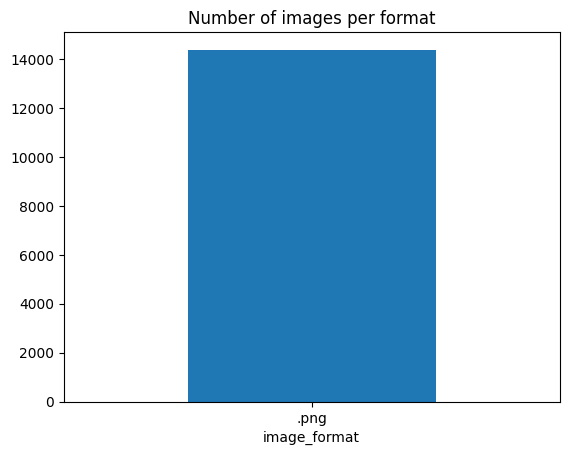

In [9]:
df['image_format'].value_counts().plot(kind='bar', title='Number of images per format')
plt.xticks(rotation=0)

<a name="2.3"></a>
## **<h1 id="2.3" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Metadata Consistency</h1>**

### Checking the consistency of metadata

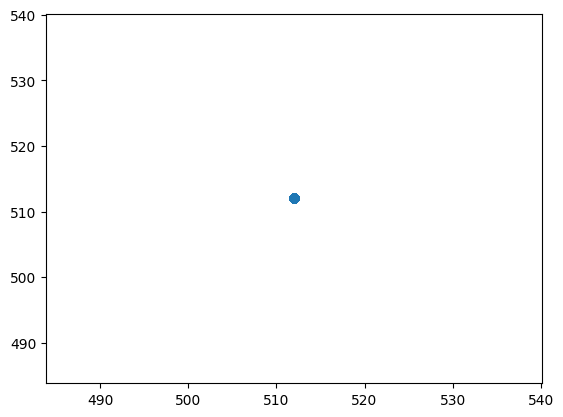

In [10]:
plt.scatter(df['width'], df['height'])

In [11]:
df.isnull().sum()

image_path      0
corrupted       0
image_hash      0
image_format    0
width           0
height          0
channels        0
label           0
dtype: int64

<a name="2.4"></a>
## **<h1 id="2.4" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Image Quality</h1>**

### Analyzing the quality of images

In [12]:
df['corrupted'].sum()

0

In [13]:
df['corrupted'].value_counts()

corrupted
False    14377
Name: count, dtype: int64

<a name="2.5"></a>
## **<h1 id="2.5" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Classes Distribution</h1>**

### Cheking the distribution of classes

label
dog         456
cat         432
frog        312
elephant    288
cheetah     216
           ... 
leopard     216
peacock     216
squid       215
jaguar      186
mole        176
Name: count, Length: 64, dtype: int64


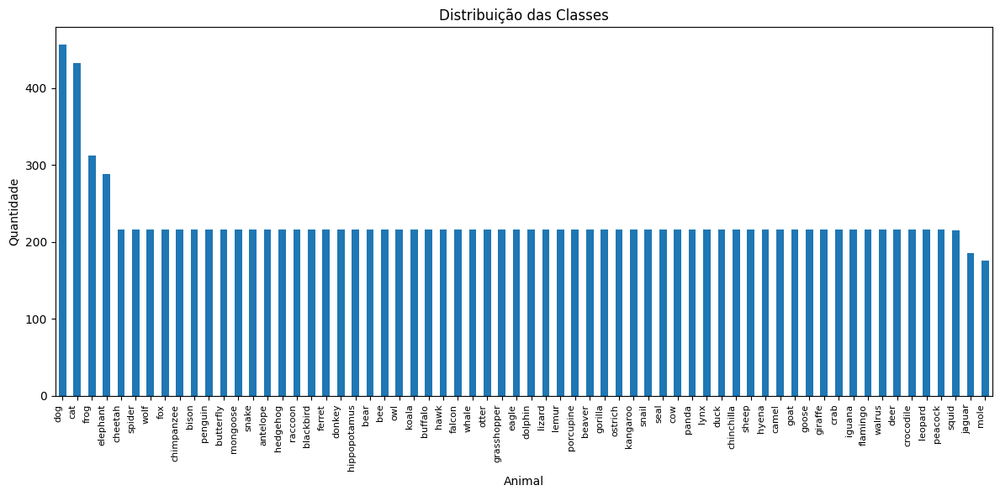

In [14]:
class_distribution = df['label'].value_counts()
print(class_distribution)

class_distribution.plot(kind='bar', figsize=(12, 6))
plt.title('Distribuição das Classes')
plt.xlabel('Animal')
plt.ylabel('Quantidade')

plt.xticks(rotation=90, ha='right', fontsize=8)
plt.tight_layout()
plt.show()

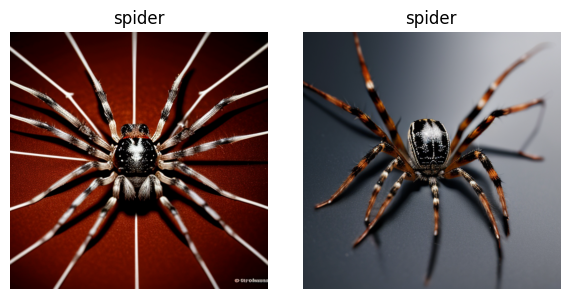

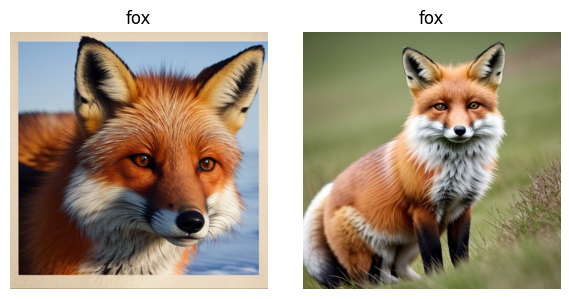

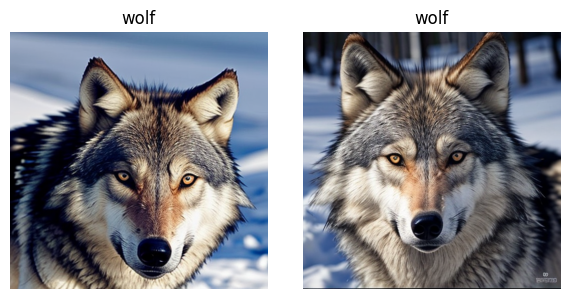

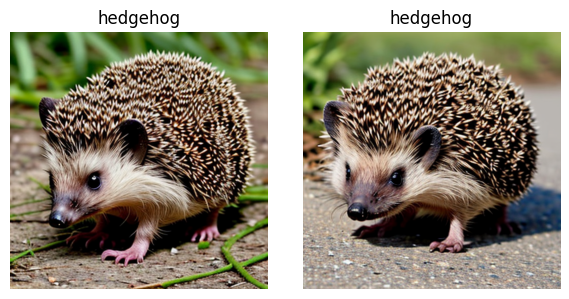

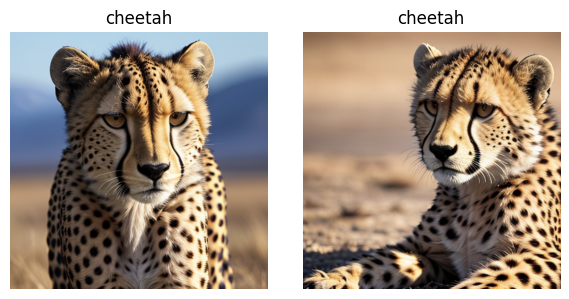

...

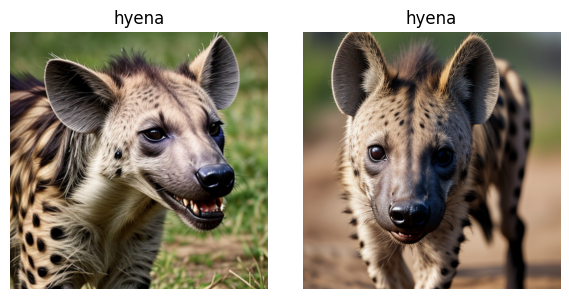

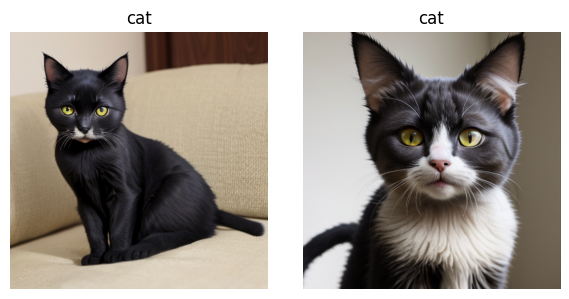

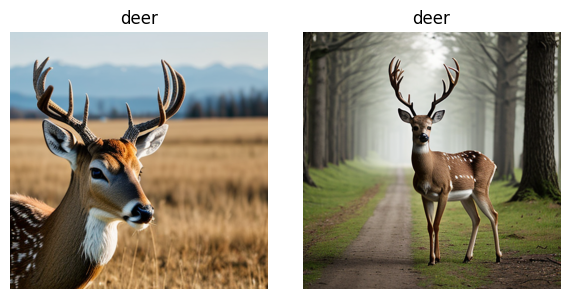

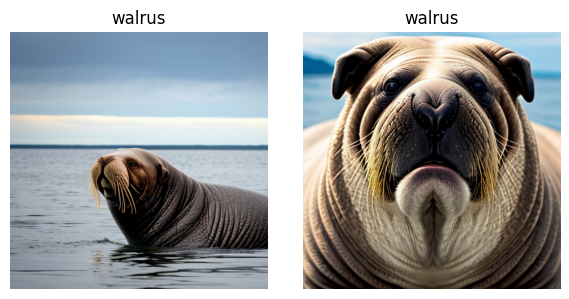

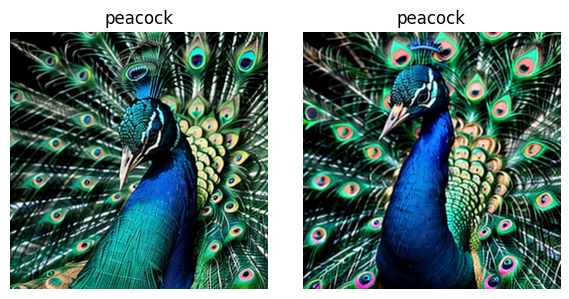

In [15]:
unique_labels = df['label'].unique()

for label in unique_labels:
   subset = df[df['label'] == label]
   image_paths = subset['image_path'].sample(2).tolist()

   fig, axes = plt.subplots(1, 2, figsize=(6, 3))
   for i, image_path in enumerate(image_paths):
       img = plt.imread(image_path)
       axes[i].imshow(img)
       axes[i].set_title(label)
       axes[i].axis('off')

   plt.tight_layout()
   plt.show()

<a name="2.6"></a>
## **<h1 id="2.6" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Duplicates</h1>**

### Checking for the presence of duplicatess

In [16]:
df['image_hash'].duplicated().sum()

0

<a name="3"></a>
#  **<h1 id="3" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Preprocessing</h1>**

___

In [17]:
class CONFIG:
    IMAGE_HEIGHT = 224
    IMAGE_WIDTH = 224
    CHANNELS = 3

    DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    N_CLASSES = df['label'].nunique()
    
    BATCH_SIZE = 16
    N_EPOCHS = 50
    PATIENCE_EPOCHS = 10
    LR = 0.001
    L2 = 0.0001
    DROPOUT = 0.3

    PATIENCE_SCHEDULER = 5

    MIN_VALUE_ACCURACY = 80

    

### Transformations

In [18]:
transform = transforms.Compose([
    transforms.Resize((CONFIG.IMAGE_HEIGHT, CONFIG.IMAGE_WIDTH)),
    transforms.ToTensor(),
    transforms.ColorJitter(brightness=0.3, contrast=0.2, saturation=0.2),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0), ratio=(0.9, 1.1)),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

### Splitting the datasets

In [19]:
dataset = datasets.ImageFolder(root=root_dir, transform=transform)

train_size = int(0.7 * len(dataset))
val_size = int(0.15 * len(dataset))
test_size = len(dataset) - train_size - val_size
train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])


### Loading datasets

In [20]:
train_loader = DataLoader(train_dataset, batch_size=CONFIG.BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=CONFIG.BATCH_SIZE, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=CONFIG.BATCH_SIZE, shuffle=False)

<a name="4"></a>
#  **<h1 id="4" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Building the Model</h1>**

___

### Implementing an EficcientNet model

In [21]:
model = models.efficientnet_b2(weights=models.EfficientNet_B2_Weights.DEFAULT)
model.classifier = nn.Sequential(
    nn.Dropout(
        p=CONFIG.DROPOUT, 
        inplace=True
        ), 
    nn.Linear(
        model.classifier[1].in_features, 
        CONFIG.N_CLASSES,  
        bias=True
        )
    )

Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-c35c1473.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-c35c1473.pth
100%|██████████| 35.2M/35.2M [00:00<00:00, 141MB/s]


### Model configuration

In [22]:
efficientnet = models.efficientnet_b2(weights=models.EfficientNet_B2_Weights.DEFAULT)

print(f'Default: {efficientnet.classifier}\n\n CustomModel: {model.classifier}')

Default: Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1408, out_features=1000, bias=True)
)

 CustomModel: Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1408, out_features=64, bias=True)
)


### Model summary

In [23]:
summary(model, input_size=(CONFIG.BATCH_SIZE, CONFIG.CHANNELS, CONFIG.IMAGE_HEIGHT, CONFIG.IMAGE_WIDTH))

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [16, 64]                  --
├─Sequential: 1-1                                       [16, 1408, 7, 7]          --
│    └─Conv2dNormActivation: 2-1                        [16, 32, 112, 112]        --
│    │    └─Conv2d: 3-1                                 [16, 32, 112, 112]        864
│    │    └─BatchNorm2d: 3-2                            [16, 32, 112, 112]        64
│    │    └─SiLU: 3-3                                   [16, 32, 112, 112]        --
│    └─Sequential: 2-2                                  [16, 16, 112, 112]        --
│    │    └─MBConv: 3-4                                 [16, 16, 112, 112]        1,448
│    │    └─MBConv: 3-5                                 [16, 16, 112, 112]        612
│    └─Sequential: 2-3                                  [16, 24, 56, 56]          --
│    │    └─MBConv: 3-6                                

<a name="5"></a>
#  **<h1 id="5" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Model Training</h1>**

___

### Configuring the early stop

In [24]:
class EarlyStopping:
    def __init__(self, patience=0, verbose=False, min_delta=0, path="checkpoint.pth", min_val_acc=0):
        self.patience = patience
        self.verbose = verbose
        self.min_delta = min_delta
        self.path = path
        self.min_val_acc = min_val_acc
        self.counter = 0
        self.best_score = None
        self.early_stop = False

    def __call__(self, model, optimizer, scheduler, train_losses, val_losses, train_accuracies, val_accuracies, learning_rate, l2_norm, epochs):
        if val_accuracies[-1] < self.min_val_acc:
            if self.verbose:
                print(f"Validation accuracy {val_accuracies[-1]:.4f} did not reach minimum {self.min_val_acc:.4f}. Not saving.")
            return

        score = val_accuracies[-1]

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(model, optimizer, scheduler, train_losses, val_losses, train_accuracies, val_accuracies, learning_rate, l2_norm, epochs)
        elif score < self.best_score + self.min_delta:
            self.counter += 1
            if self.verbose:
                print(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(model, optimizer, scheduler, train_losses, val_losses, train_accuracies, val_accuracies, learning_rate, l2_norm, epochs)
            self.counter = 0

    def save_checkpoint(self, model, optimizer, scheduler, train_losses, val_losses, train_accuracies, val_accuracies, learning_rate, l2_norm, epochs):
        if self.verbose:
            print(f"Validation accuracy improved. Saving model with val_loss {val_losses[-1]:.6f}...")

        training_state = {
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "scheduler_state_dict": scheduler.state_dict() if scheduler else None,
            "train_losses": train_losses,
            "val_losses": val_losses,
            "train_accuracies": train_accuracies,
            "val_accuracies": val_accuracies,
            "hyperparameters": {
                "learning_rate": learning_rate,
                "L2 norm": l2_norm,
                "batch_size": 32,
                "epochs": epochs,
            }
        }
        torch.save(training_state, self.path)

### Defining the Loss Function, Optimizer and the Decreasing Learning Rate

In [25]:
criterion = nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(model.parameters(), lr=CONFIG.LR, weight_decay=CONFIG.L2)

scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=CONFIG.PATIENCE_SCHEDULER)

### Training and Evaluation

In [26]:
def train_model(model, data_loader, criterion, optimizer, device):
    model.train()
    train_loss, train_correct, train_total = 0, 0, 0
    for inputs, labels in data_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        train_correct += (predicted == labels).sum().item()
        train_total += labels.size(0)

    avg_loss = train_loss / len(data_loader)
    train_accuracy = 100 * train_correct / train_total

    return avg_loss, train_accuracy


In [27]:
def evaluate_model(model, data_loader, criterion, device):
    model.eval()
    val_loss, val_correct, val_total = 0, 0, 0
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            
            _, predicted = torch.max(outputs.data, 1)
            val_correct += (predicted == labels).sum().item()
            val_total += labels.size(0)
    
    avg_loss = val_loss / len(data_loader)
    val_accuracy = 100 * val_correct / val_total

    scheduler.step(val_loss)
    current_lr = scheduler.get_last_lr()[0]
    
    return avg_loss, val_accuracy, current_lr
    

In [28]:
train_accuracies = []
val_accuracies = []
train_losses = []
val_losses = []

early_stopping = EarlyStopping(patience=CONFIG.PATIENCE_EPOCHS, verbose=True, min_val_acc=CONFIG.MIN_VALUE_ACCURACY, path="best_model.pth")

for epoch in range(CONFIG.N_EPOCHS):
    train_loss, train_accuracy = train_model(model, train_loader, criterion, optimizer, CONFIG.DEVICE)
    val_loss, val_accuracy, current_lr = evaluate_model(model, val_loader, criterion, CONFIG.DEVICE)

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accuracies.append(train_accuracy)
    val_accuracies.append(val_accuracy)
    
    print(f"Epoch {epoch+1}/{CONFIG.N_EPOCHS}")
    print(f"Train Loss: {train_loss:.4f} | Train Accuracy: {train_accuracy:.2f}%")
    print(f"Validation Loss: {val_loss:.4f} | Validation Accuracy: {val_accuracy:.2f}%")
    print(f"Learning Rate: {current_lr}")

    early_stopping(model, optimizer, scheduler, train_losses, val_losses, train_accuracies, val_accuracies, CONFIG.LR, CONFIG.L2, CONFIG.N_EPOCHS)
    if early_stopping.early_stop:
        print("Early stopping activated. Stopping training.")
        break


Epoch 1/50
Train Loss: 0.4788 | Train Accuracy: 87.97%
Validation Loss: 0.1017 | Validation Accuracy: 96.80%
Learning Rate: 0.001
Validation accuracy improved. Saving model with val_loss 0.101696...
Epoch 2/50
Train Loss: 0.1543 | Train Accuracy: 95.55%
Validation Loss: 0.2273 | Validation Accuracy: 96.52%
Learning Rate: 0.001
EarlyStopping counter: 1 out of 10
Epoch 3/50
Train Loss: 0.1420 | Train Accuracy: 95.73%
Validation Loss: 0.2029 | Validation Accuracy: 96.06%
Learning Rate: 0.001
EarlyStopping counter: 2 out of 10
Epoch 4/50
Train Loss: 0.1186 | Train Accuracy: 96.58%
Validation Loss: 0.0894 | Validation Accuracy: 97.59%
Learning Rate: 0.001
Validation accuracy improved. Saving model with val_loss 0.089433...
Epoch 5/50
Train Loss: 0.1177 | Train Accuracy: 96.62%
Validation Loss: 0.0323 | Validation Accuracy: 99.07%
Learning Rate: 0.001
Validation accuracy improved. Saving model with val_loss 0.032320...
Epoch 6/50
Train Loss: 0.0997 | Train Accuracy: 97.13%
Validation Loss: 0

In [29]:
checkpoint = torch.load("best_model.pth")
model.load_state_dict(checkpoint["model_state_dict"])

/tmp/ipykernel_23/470373151.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("best_model.pth")


<All keys matched successfully>

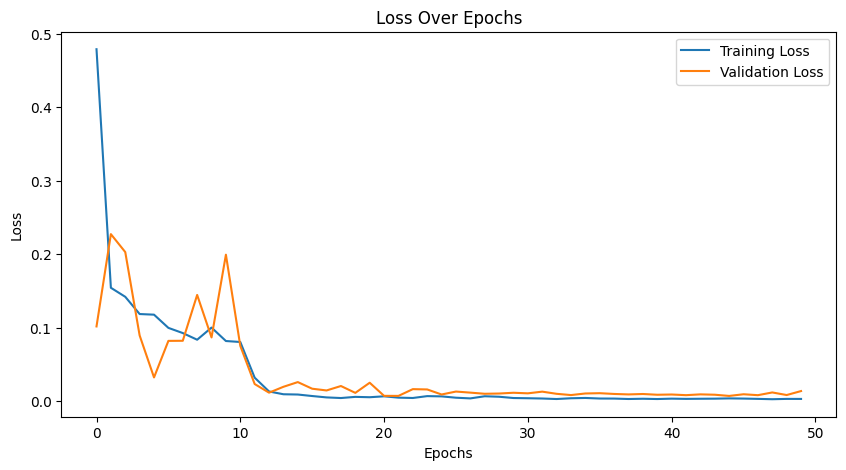

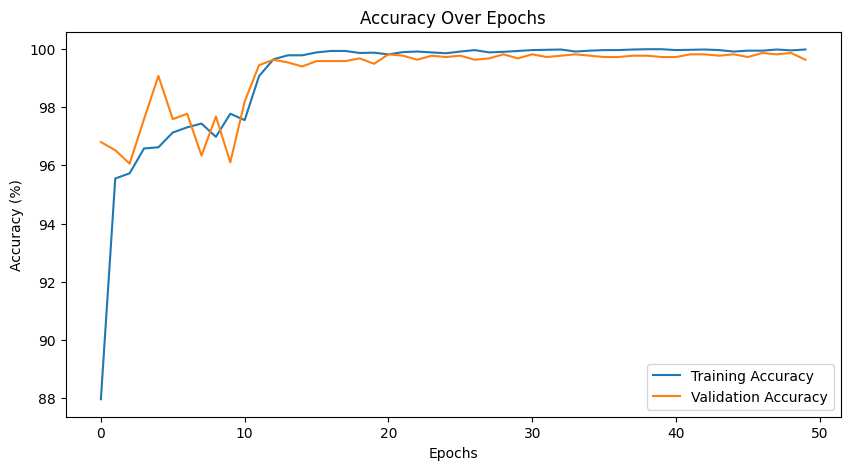

In [30]:
# Loss plot
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label="Training Loss")
plt.plot(val_losses, label="Validation Loss")
plt.title("Loss Over Epochs")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Accuracy plot
plt.figure(figsize=(10, 5))
plt.plot(train_accuracies, label="Training Accuracy")
plt.plot(val_accuracies, label="Validation Accuracy")
plt.title("Accuracy Over Epochs")
plt.xlabel("Epochs")
plt.ylabel("Accuracy (%)")
plt.legend()
plt.show()

<a name="6"></a>
#    **<h1 id="6" style="font-family:cnewtimeroman; font-size: 120%; color: #000000; text-align: center;">Model Testing and Results</h1>**

___

### Testing

In [31]:
def test(model, test_loader):
    model.eval()
    test_loss = 0
    total = 0
    correct = 0
    all_labels = []
    predictions = []
    all_probs = []
    
    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(CONFIG.DEVICE), labels.to(CONFIG.DEVICE)
            outputs = model(inputs)

            loss = criterion(outputs, labels)
            test_loss += loss.item()

            probs = F.softmax(outputs, dim=1)
            _, predicted = torch.max(probs, 1)
            all_labels.extend(labels.cpu().numpy())
            predictions.extend(predicted.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())

            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        test_loss /= len(test_loader)
        accuracy = 100 * correct / total
    
    return all_labels, predictions, all_probs, total, correct, test_loss, accuracy

all_labels, predictions, all_probs, total, correct, test_loss, accuracy = test(model, test_loader)


### Metrics

In [32]:
recall = recall_score(all_labels, predictions, average='weighted')
f1 = f1_score(all_labels, predictions, average='weighted')

num_classes = len(set(all_labels))
y_true_bin = label_binarize(all_labels, classes=list(range(num_classes)))
roc_auc = roc_auc_score(y_true_bin, all_probs, multi_class='ovr')

results_df = pd.DataFrame({
    'True Label': all_labels,
    'Prediction': predictions
})

metrics_df = pd.DataFrame({
    'Metric': ['Total Samples', 'Correct Predictions', 'Test Loss', 'Accuracy', 'Recall', 'F1 Score', 'AUC-ROC'],
    'Value': [total, correct, test_loss, accuracy, recall, f1, roc_auc]
})


print("Results (True Labels vs Predictions):")
print(results_df.head())

print("\nMetrics Summary:")
print(metrics_df)

Results (True Labels vs Predictions):
   True Label  Prediction
0          49          49
1          11          11
2          23          23
3          10          10
4           3           3

Metrics Summary:
                Metric        Value
0        Total Samples  2158.000000
1  Correct Predictions  2154.000000
2            Test Loss     0.008125
3             Accuracy    99.814643
4               Recall     0.998146
5             F1 Score     0.998148
6              AUC-ROC     0.999998


### Confusion Matrix

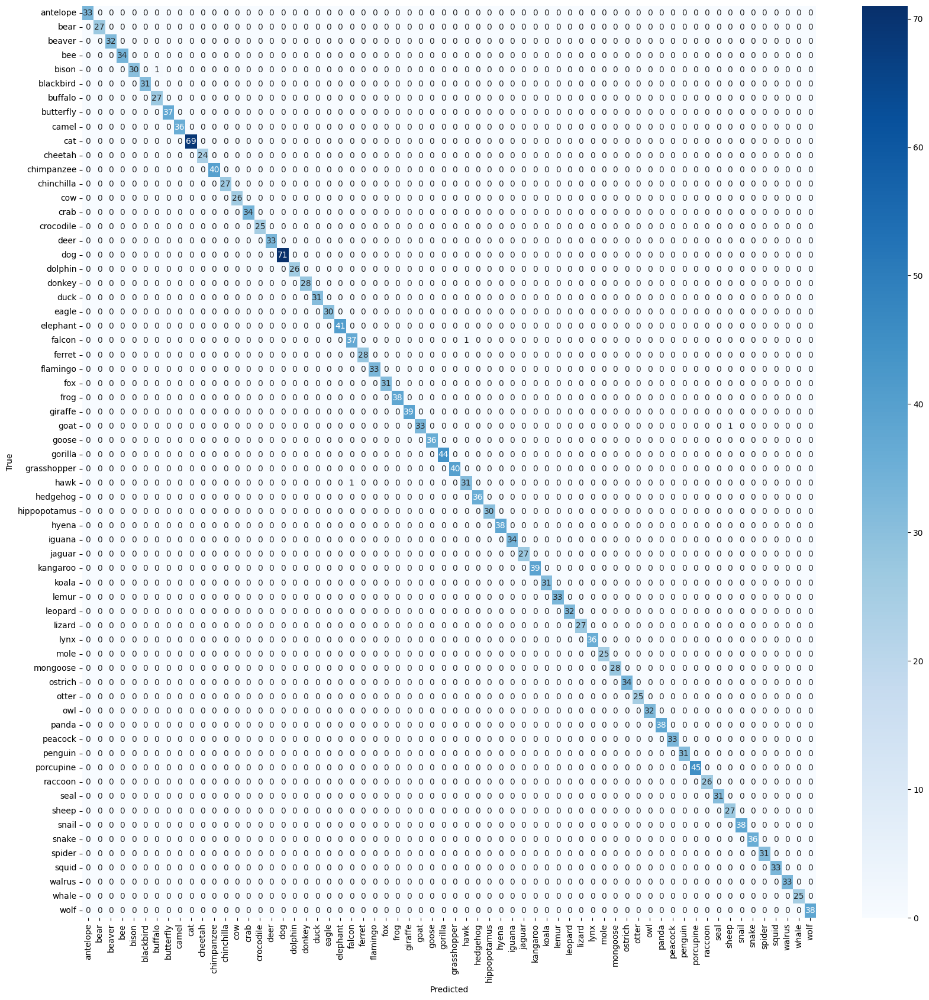

In [33]:
class_names = {v: k for k, v in dataset.class_to_idx.items()}
class_labels = [class_names[i] for i in range(len(class_names))]

conf_matrix = confusion_matrix(all_labels, predictions)

plt.figure(figsize=(20, 20))

sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel("Predicted")
plt.ylabel("True")
plt.show()